In [1]:
import layoutparser as lp
import cv2 as cv

from surya.detection import batch_text_detection
from surya.model.detection.segformer import load_model, load_processor
from surya.layout import batch_layout_detection
from surya.settings import settings

from PIL import Image
import numpy as np
import matplotlib.pyplot as plt

import torch
import clip
import tqdm



/home/cboned/miniconda3/envs/tfm/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:

def draw_polygons(image, polygons, color=(255, 0, 0), thickness=2):
    """
    Draws polygons on the given image.

    Parameters:
    image (numpy.ndarray): The input image on which polygons are to be drawn.
    polygons (list of list of list of int): A list of polygons, where each polygon is represented
                                            as a list of points, and each point is a list of two integers [x, y].
    color (tuple of int, optional): Color of the polygon lines in BGR format. Default is green (0, 255, 0).
    thickness (int, optional): Thickness of the polygon lines. Default is 2.

    Returns:
    numpy.ndarray: The image with polygons drawn on it.
    """
    # Make a copy of the image to avoid modifying the original one
    output_image = image.copy()

    # Iterate over each polygon
    for polygon in polygons:
        # Convert the list of points to a numpy array of shape (n, 1, 2), required by polylines
        pts = np.array(polygon, np.int32).reshape((-1, 1, 2))
        # Draw the polygon on the image
        cv.drawContours(output_image, [pts], -1, color, thickness)

    return output_image



def extract_bounding_box(polygon):
    """
    Extracts the bounding box (x, y, w, h) from a given polygon.

    Parameters:
    polygon (list of list of int): A list of points representing the polygon.

    Returns:
    tuple: A tuple containing (x, y, w, h) which represents the bounding box.
    """
    # Convert the polygon points to a numpy array for easier manipulation
    pts = np.array(polygon)

    # Extract x and y coordinates
    x_coords = pts[:, 0]
    y_coords = pts[:, 1]

    # Calculate the minimum and maximum x and y values
    x_min = np.min(x_coords)
    x_max = np.max(x_coords)
    y_min = np.min(y_coords)
    y_max = np.max(y_coords)

    # Calculate the width and height
    w = x_max - x_min
    h = y_max - y_min

    return x_min, y_min, w, h


def generate_polygon(x, y, w, h):
    """
    Generates a polygon (rectangle) given the bounding box parameters (x, y, w, h).

    Parameters:
    x (int): The x-coordinate of the top-left corner of the bounding box.
    y (int): The y-coordinate of the top-left corner of the bounding box.
    w (int): The width of the bounding box.
    h (int): The height of the bounding box.

    Returns:
    list of list of int: A list of points representing the polygon (rectangle).
    """
    # Define the four corners of the rectangle
    polygon = [
        [x, y],         # Top-left corner
        [x + w, y],     # Top-right corner
        [x + w, y + h], # Bottom-right corner
        [x, y + h]      # Bottom-left corner
    ]
    
    return polygon


In [3]:
def calculate_center(box):
    x, y, w, h = box
    return (x + w / 2, y + h / 2)

def are_horizontally_aligned(box1, box2, confidence_interval):
    _, y1_center = calculate_center(box1)
    _, y2_center = calculate_center(box2)
    return abs(y1_center - y2_center) <= confidence_interval

def merge_boxes(box1, box2):
    x1, y1, w1, h1 = box1
    x2, y2, w2, h2 = box2
    new_x = min(x1, x2)
    new_y = min(y1, y2)
    new_w = max(x1 + w1, x2 + w2) - new_x
    new_h = max(y1 + h1, y2 + h2) - new_y
    return (new_x, new_y, new_w, new_h)

def merge_horizontally_aligned_bounding_boxes(boxes, confidence_interval):
    merged = True
    while merged:
        merged = False
        new_boxes = []
        skip_indices = set()
        
        for i in range(len(boxes)):
            if i in skip_indices:
                continue
            box1 = boxes[i]
            merged_box = box1
            
            for j in range(i + 1, len(boxes)):
                if j in skip_indices:
                    continue
                box2 = boxes[j]
                
                if are_horizontally_aligned(merged_box, box2, confidence_interval):
                    merged_box = merge_boxes(merged_box, box2)
                    skip_indices.add(j)
                    merged = True
            
            new_boxes.append(merged_box)
        
        boxes = new_boxes
    
    return boxes




In [4]:
IMAGE_PATH = "../data/Documents/SFLL/1924/050000120052059,0021.jpg"
image = Image.open(IMAGE_PATH)


## Layout Extraction

In [5]:
def create_visual_label(patch, output_argmax):
    
    zeros = np.zeros_like(patch)
    # index = 2 if output_argmax else 0
    zeros[:, :, output_argmax] = 255
    
    return zeros

def segment_image(image, M, N, queries, return_sep = False):
    # Tiles for segmentation, recomended: word-shaped
    tiles = [image[x:x+M,y:y+N] for x in range(0,image.shape[0],M) for y in range(0,image.shape[1],N)]
    indices = [(x, x+M, y, y+N) for x in range(0,image.shape[0],M) for y in range(0,image.shape[1],N)]
    
    # CLIP SetUp
    device = "cuda" if torch.cuda.is_available() else "cpu"
    model, preprocess = clip.load("ViT-B/32", device=device)

    text = clip.tokenize(queries).to(device)
    
    canvas = np.zeros_like(image)
    
    for (x, w, y, h), tile in tqdm.tqdm(zip(indices, tiles)):
        with torch.no_grad():
            tile_pil = Image.fromarray(tile)
            image_input = preprocess(tile_pil).unsqueeze(0).to(device)

            logits_per_image, logits_per_text = model(image_input, text)
            probs = logits_per_image.softmax(dim=-1).cpu().numpy()

            visual_label = create_visual_label(tile, probs.argmax()) * probs.max()
            canvas[x:w, y:h, :] = visual_label
        
    canvas_uint = canvas.astype(np.uint8) / 255
    if return_sep: return canvas_uint, image/255
    
    masked = canvas_uint * 0.5 + (image / 255) * 0.5
    
    return masked

In [6]:
model = load_model(checkpoint=settings.LAYOUT_MODEL_CHECKPOINT)
processor = load_processor(checkpoint=settings.LAYOUT_MODEL_CHECKPOINT)
det_model = load_model()
det_processor = load_processor()
line_predictions = batch_text_detection([image], det_model, det_processor)
layout_predictions = batch_layout_detection([image], model, processor, line_predictions)

Loading detection model vikp/surya_layout2 on device cuda with dtype torch.float16
Loading detection model vikp/surya_det2 on device cuda with dtype torch.float16


Detecting bboxes:   0%|          | 0/1 [00:00<?, ?it/s]/home/cboned/miniconda3/envs/tfm/lib/python3.10/site-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,
Detecting bboxes: 100%|██████████| 1/1 [00:00<00:00,  8.11it/s]


In [7]:
layout_predictions[0].image_bbox

[0.0, 0.0, 1603.0, 1218.0]

In [8]:
#IMAGE_PATH = "../data/Documents/SFLL/1945/050000120052065,0003.jpg"

image = Image.open(IMAGE_PATH).convert("RGB")

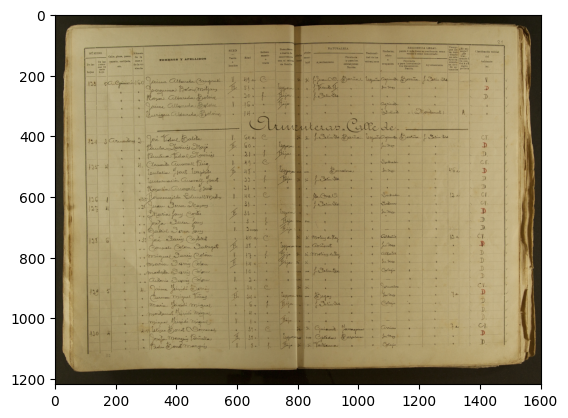

In [9]:
plt.imshow(image)

In [10]:
np.array(image).shape

(1218, 1603, 3)

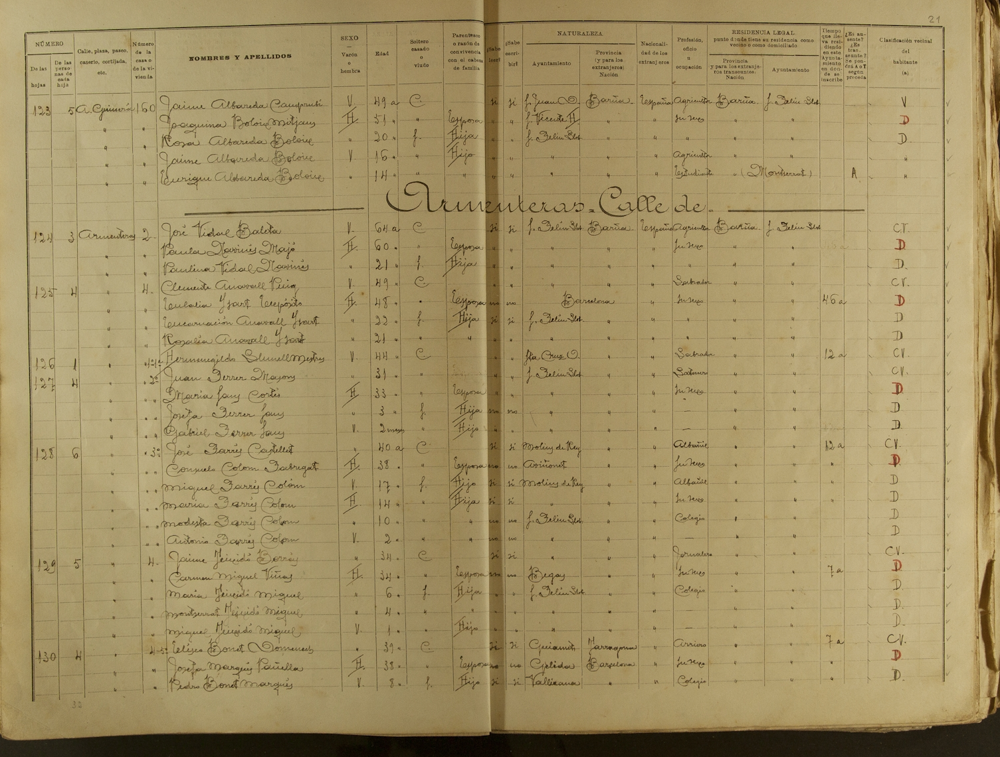

In [12]:
x, y, w, h = layout_predictions[0].bboxes[0].bbox
#image = Image.open(IMAGE_PATH)
img = np.array(image)
#cropping
cropped_image = img[y:y+h, x:x+w]
cropped_image = Image.fromarray(cropped_image)
cropped_image

In [13]:

cropped_image = image
model, processor = load_model(), load_processor()

# predictions is a list of dicts, one per image
predictions = batch_text_detection([cropped_image], model, processor)

Loading detection model vikp/surya_det2 on device cuda with dtype torch.float16


Detecting bboxes: 100%|██████████| 1/1 [00:00<00:00,  5.11it/s]


In [14]:
test = predictions[0]

print(test.bboxes)

[PolygonBox(polygon=[[570, 114], [599, 114], [599, 124], [570, 124]], confidence=0.7613897919654846, bbox=[570, 114, 599, 124]), PolygonBox(polygon=[[619, 137], [645, 137], [645, 148], [619, 148]], confidence=0.6663267016410828, bbox=[619, 137, 645, 148]), PolygonBox(polygon=[[570, 139], [597, 139], [597, 151], [570, 151]], confidence=0.6667373180389404, bbox=[570, 139, 597, 151]), PolygonBox(polygon=[[1212, 204], [1293, 204], [1293, 222], [1212, 222]], confidence=0.7377872467041016, bbox=[1212, 204, 1293, 222]), PolygonBox(polygon=[[574, 206], [594, 206], [594, 223], [574, 223]], confidence=0.7118304967880249, bbox=[574, 206, 594, 223]), PolygonBox(polygon=[[614, 206], [697, 204], [697, 225], [614, 226]], confidence=0.8700241446495056, bbox=[614, 206, 697, 225]), PolygonBox(polygon=[[951, 206], [1009, 206], [1009, 217], [951, 217]], confidence=0.7528087496757507, bbox=[951, 206, 1009, 217]), PolygonBox(polygon=[[1135, 207], [1197, 205], [1198, 218], [1135, 220]], confidence=0.75778001

In [15]:
bboxs = [i.polygon for i in test.bboxes]

In [16]:
out = draw_polygons(np.array(cropped_image)/255, bboxs)

In [17]:
image_uint8 = (out * 255).astype(np.uint8)
imagee = Image.fromarray(image_uint8)

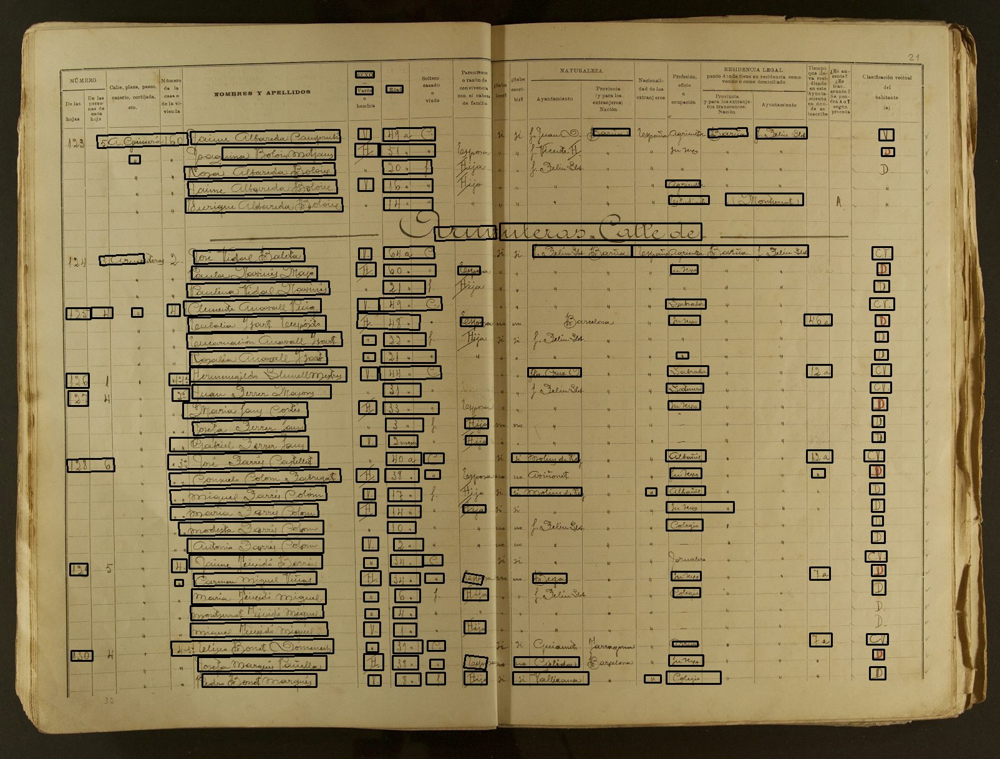

In [18]:
imagee

In [19]:
bboxes = [extract_bounding_box(i) for i in bboxs]
#bboxes = [i.bbox for i in test.bboxes]

In [20]:
print(sorted(bboxes, key=lambda x: x[0]))

[(106, 494, 39, 18), (106, 599, 36, 23), (107, 735, 76, 22), (109, 627, 32, 24), (112, 904, 28, 19), (114, 1044, 34, 16), (146, 493, 34, 17), (155, 213, 146, 24), (159, 407, 72, 18), (207, 249, 17, 13), (211, 494, 17, 14), (268, 488, 20, 19), (269, 725, 241, 28), (271, 599, 33, 19), (271, 752, 275, 28), (272, 700, 222, 24), (272, 779, 251, 30), (273, 808, 237, 26), (274, 1025, 260, 27), (275, 897, 24, 21), (276, 623, 27, 20), (280, 930, 13, 10), (286, 835, 232, 24), (293, 645, 200, 26), (294, 479, 220, 27), (295, 261, 242, 26), (297, 317, 252, 24), (299, 451, 229, 26), (299, 532, 249, 27), (300, 864, 218, 23), (301, 288, 239, 26), (301, 506, 221, 27), (303, 890, 213, 22), (304, 561, 220, 26), (304, 589, 251, 23), (305, 208, 240, 23), (305, 969, 213, 26), (305, 998, 220, 24), (307, 427, 201, 21), (307, 945, 215, 24), (308, 617, 222, 22), (308, 670, 181, 28), (310, 398, 178, 25), (310, 917, 197, 23), (317, 1052, 206, 25), (324, 1081, 183, 21), (356, 236, 181, 20), (569, 230, 40, 21), (57

In [21]:
x_variation = [i[0] for i in sorted(bboxes, key=lambda x: x[0])]


In [22]:


extract_xaxis_variance = [i for i in sorted(bboxes, key=lambda x: x[0]) if i[0] <= np.std(x_variation)]


In [23]:
test = [generate_polygon(*i) for i in sorted(bboxes, key=lambda x: x[0]) if i[0] < np.std(x_variation)]

In [24]:
new_out = draw_polygons(np.array(cropped_image)/255, polygons=test)

In [25]:
image_uint8 = (new_out * 255).astype(np.uint8)
imagee2 = Image.fromarray(image_uint8)

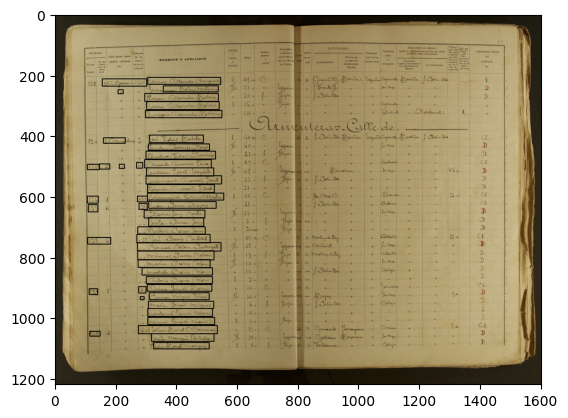

In [26]:
plt.imshow(imagee2)

In [27]:
confidence_interval = 20  # Adjust the confidence interval as needed
merged_boxes = merge_horizontally_aligned_bounding_boxes(sorted(extract_xaxis_variance, key=lambda x: x[1]), confidence_interval=confidence_interval)

print("Merged Bounding Boxes:", len(merged_boxes))

Merged Bounding Boxes: 31


In [28]:
test = [generate_polygon(*i) for i in merged_boxes]

In [29]:
new_out = draw_polygons(np.array(cropped_image)/255, polygons=test)

In [30]:
image_uint8 = (new_out * 255).astype(np.uint8)
imagee2 = Image.fromarray(image_uint8)

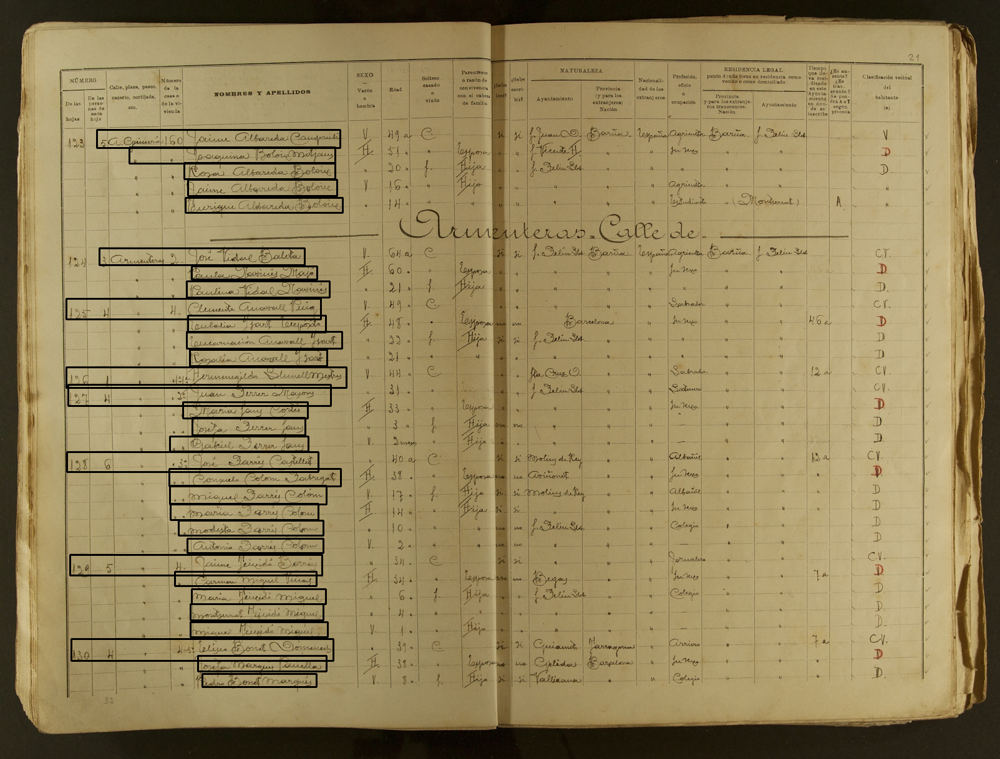

In [31]:
imagee2

In [32]:
import copy
true_test = copy.copy(merged_boxes)
true_test = sorted(merged_boxes, key=lambda x: x[1])


mena_distances_bbox = {}

for bbox_idx in range(len(true_test) - 1):
    x_act, y_act, w_act, h_act =  true_test[bbox_idx]
    x_nex, y_next, w_next, h_next = true_test[bbox_idx+1]

    a = [x_act, y_act, w_act, h_act]
    b = [x_nex, y_next, w_next, h_next]

    bottom_line = y_act + h_act
    next_top_line = y_next
    mena_distances_bbox[(str(a), str(b))] = abs((y_act + h_act) - y_next)
    print(a, b)
    print(abs((y_act + h_act) - y_next))

mean_consecutive_distances = np.mean(list(mena_distances_bbox.values()))
std_consecutive_distances = np.std(list(mena_distances_bbox.values()))



print((mean_consecutive_distances))
print((std_consecutive_distances))


[155, 208, 390, 29] [207, 236, 330, 26]
1
[207, 236, 330, 26] [295, 261, 242, 26]
1
[295, 261, 242, 26] [301, 288, 239, 26]
1
[301, 288, 239, 26] [297, 317, 252, 24]
3
[297, 317, 252, 24] [159, 398, 329, 27]
57
[159, 398, 329, 27] [307, 427, 201, 21]
2
[307, 427, 201, 21] [299, 451, 229, 26]
3
[299, 451, 229, 26] [106, 479, 408, 33]
2
[106, 479, 408, 33] [301, 506, 221, 27]
6
[301, 506, 221, 27] [299, 532, 249, 27]
1
[299, 532, 249, 27] [304, 561, 220, 26]
2
[304, 561, 220, 26] [106, 589, 449, 33]
2
[106, 589, 449, 33] [109, 617, 421, 34]
5
[109, 617, 421, 34] [293, 645, 200, 26]
6
[293, 645, 200, 26] [308, 670, 181, 28]
1
[308, 670, 181, 28] [272, 700, 222, 24]
2
[272, 700, 222, 24] [107, 725, 403, 32]
1
[107, 725, 403, 32] [271, 752, 275, 28]
5
[271, 752, 275, 28] [272, 779, 251, 30]
1
[272, 779, 251, 30] [273, 808, 237, 26]
1
[273, 808, 237, 26] [286, 835, 232, 24]
1
[286, 835, 232, 24] [300, 864, 218, 23]
5
[300, 864, 218, 23] [112, 890, 404, 33]
3
[112, 890, 404, 33] [280, 917, 22

In [33]:
extract_yaxis_variance = [eval(ii) for i, j in mena_distances_bbox.items() for ii in i if j < mean_consecutive_distances+ 1.2*std_consecutive_distances]

filtered = {tuple(i) for i in extract_yaxis_variance}

In [34]:
filtered_by_area = [generate_polygon(*i) for i in sorted(filtered, key=lambda x: x[1])]


In [35]:
merged_out = draw_polygons(np.array(cropped_image)/255, polygons=filtered_by_area)

In [36]:
image_uint8 = (merged_out * 255).astype(np.uint8)
merged = Image.fromarray(image_uint8)

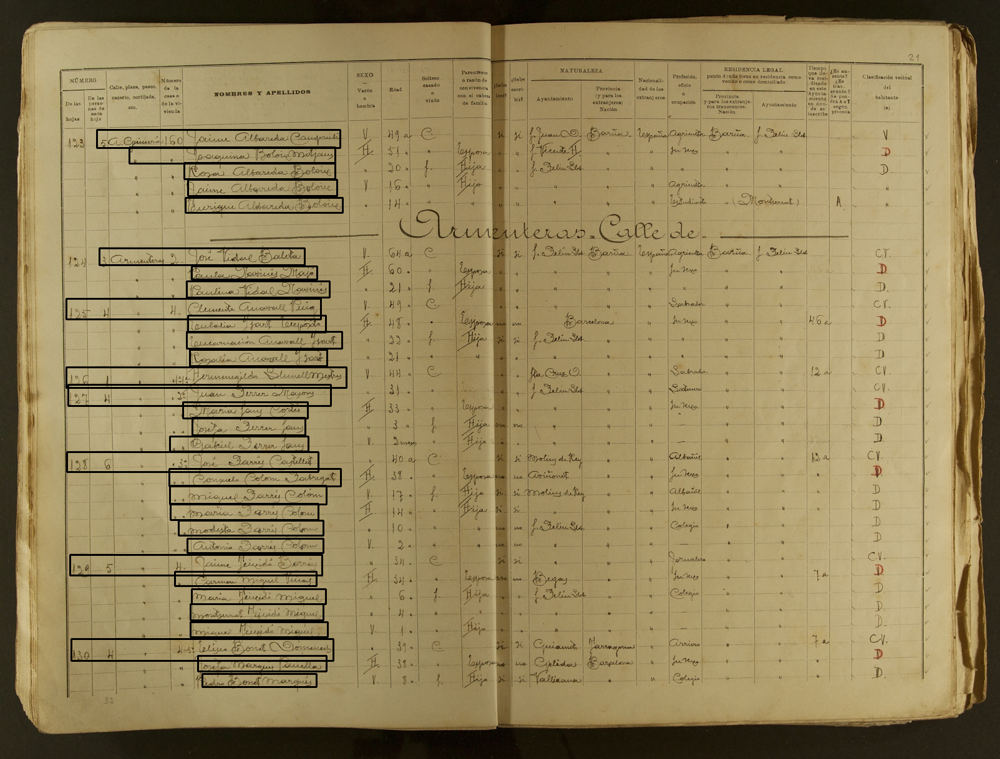

In [37]:
merged

In [38]:
ordered_merged_boxes = sorted(filtered, key=lambda x: x[1])

def get_lines_from_bboxes(ordered_merged_boxes:list[list[int, int, int, int]])-> list[list[int, int, int, int]]:
        
    lines = []
    for bbox_idx in range(len(ordered_merged_boxes)-1):
        x_act, y_act, w_act, h_act =  ordered_merged_boxes[bbox_idx]
        x_nex, y_next, w_next, h_next = ordered_merged_boxes[bbox_idx+1]

        bottom_line = y_act + h_act
        next_top_line = y_next
        if bbox_idx == 0 and (abs(bottom_line - next_top_line) > 20):
            continue

        lines.append([0, y_act , np.array(image).shape[1], h_act])

        if (bbox_idx+1) == (len(ordered_merged_boxes) -1) and  (abs(bottom_line - next_top_line) < 20):
            area_previous = y_act * w_act
            area_next = y_next * w_next
            if not area_previous > 3*area_next:

                lines.append([0, y_next , np.array(image).shape[1], h_act])


    return lines



        
lines = get_lines_from_bboxes(ordered_merged_boxes)
lines = get_lines_from_bboxes(ordered_merged_boxes=lines)
    

In [39]:
print(lines)

[[0, 208, 1603, 29], [0, 236, 1603, 26], [0, 261, 1603, 26], [0, 288, 1603, 26], [0, 317, 1603, 24], [0, 398, 1603, 27], [0, 427, 1603, 21], [0, 451, 1603, 26], [0, 479, 1603, 33], [0, 506, 1603, 27], [0, 532, 1603, 27], [0, 561, 1603, 26], [0, 589, 1603, 33], [0, 617, 1603, 34], [0, 645, 1603, 26], [0, 670, 1603, 28], [0, 700, 1603, 24], [0, 725, 1603, 32], [0, 752, 1603, 28], [0, 779, 1603, 30], [0, 808, 1603, 26], [0, 835, 1603, 24], [0, 864, 1603, 23], [0, 890, 1603, 33], [0, 917, 1603, 23], [0, 945, 1603, 24], [0, 969, 1603, 26], [0, 998, 1603, 24], [0, 1025, 1603, 35], [0, 1052, 1603, 25], [0, 1081, 1603, 25]]


In [40]:
print(len(lines))
lines_merged = [generate_polygon(*i) for i in sorted(lines, key=lambda x: x[1])]
lines_out = draw_polygons(np.array(cropped_image)/255, polygons=lines_merged)
image_uint8 = (lines_out * 255).astype(np.uint8)
lines_out = Image.fromarray(image_uint8)

31


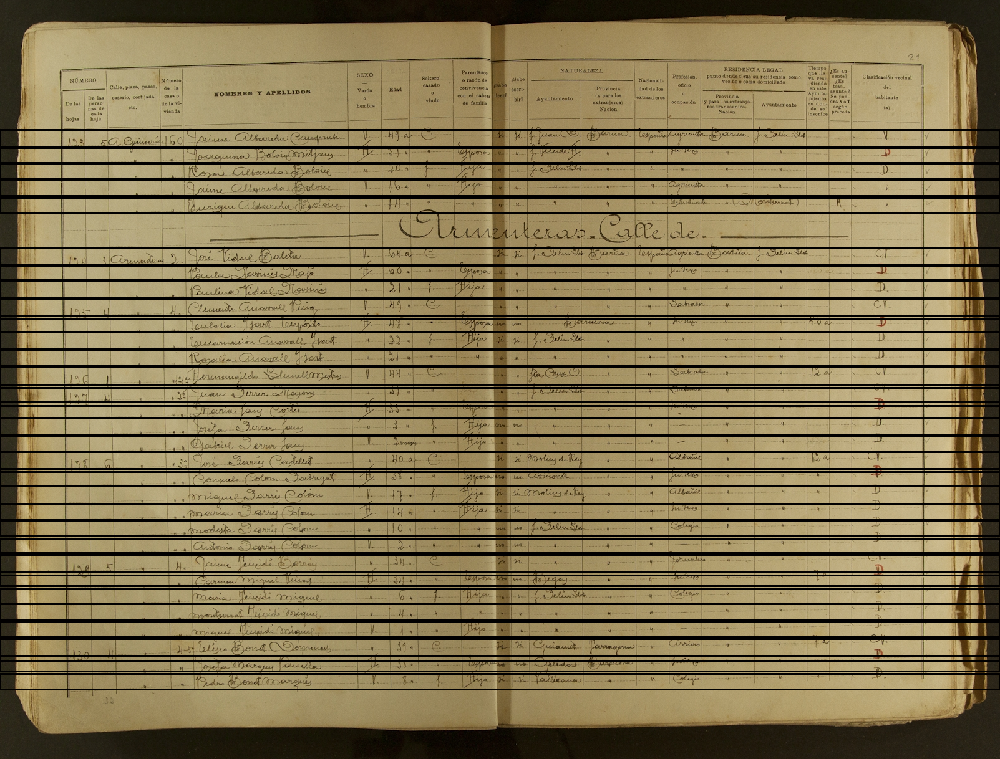

In [41]:
lines_out

In [42]:
x, y, w, h = sorted(lines, key=lambda x: x[1])[0]

In [43]:
Image.fromarray(np.array(cropped_image)[y:y+h, x:x+w])

In [44]:
example = np.array(cropped_image)[y:y+h, x:x+w]

In [45]:
flines = sorted(lines, key=lambda x: x[1])
flines

[[0, 208, 1603, 29],
 [0, 236, 1603, 26],
 [0, 261, 1603, 26],
 [0, 288, 1603, 26],
 [0, 317, 1603, 24],
 [0, 398, 1603, 27],
 [0, 427, 1603, 21],
 [0, 451, 1603, 26],
 [0, 479, 1603, 33],
 [0, 506, 1603, 27],
 [0, 532, 1603, 27],
 [0, 561, 1603, 26],
 [0, 589, 1603, 33],
 [0, 617, 1603, 34],
 [0, 645, 1603, 26],
 [0, 670, 1603, 28],
 [0, 700, 1603, 24],
 [0, 725, 1603, 32],
 [0, 752, 1603, 28],
 [0, 779, 1603, 30],
 [0, 808, 1603, 26],
 [0, 835, 1603, 24],
 [0, 864, 1603, 23],
 [0, 890, 1603, 33],
 [0, 917, 1603, 23],
 [0, 945, 1603, 24],
 [0, 969, 1603, 26],
 [0, 998, 1603, 24],
 [0, 1025, 1603, 35],
 [0, 1052, 1603, 25],
 [0, 1081, 1603, 25]]

## Handwritten / Printed Segmentation

In [46]:
M = 224
N = 96
example = np.array(cropped_image)
tiles = [example[x:x+M,y:y+N] for x in range(0,example.shape[0],M) for y in range(0,example.shape[1],N)]
indices = [(x, x+M, y, y+N) for x in range(0,example.shape[0],M) for y in range(0,example.shape[1],N)]

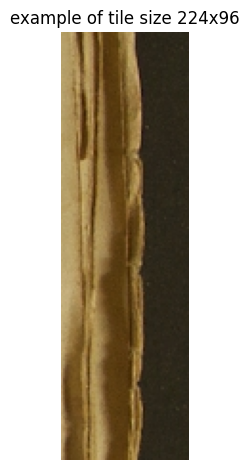

In [47]:
plt.imshow(tiles[50])
plt.title(f'example of tile size {M}x{N}')
plt.axis('off')
plt.tight_layout()
plt.show()

260it [00:19, 13.20it/s]


(1218, 1603, 3)
983394.8882352944
777636.0019607845
376005.6862745096


14it [00:01, 12.21it/s]

169it [00:12, 13.21it/s]


(1218, 1603, 3)
1097631.9392156855
679902.3549019606
366196.92941176455


104it [00:08, 12.93it/s]


(1218, 1603, 3)
1001383.0921568625
753697.5549019607
375049.4117647058


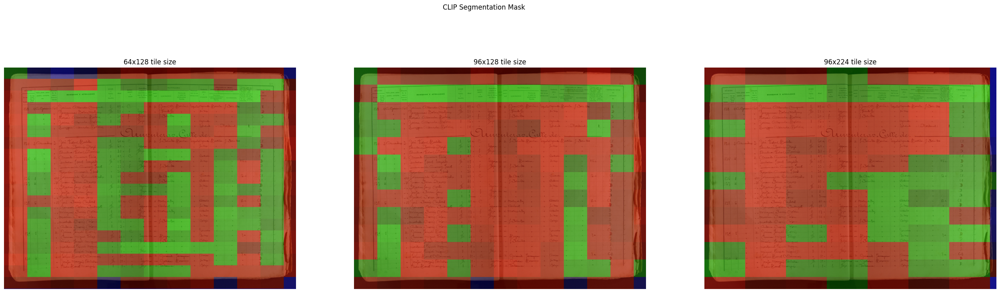

In [48]:
resolutions_to_try = [(64, 128), (96, 128), (96, 224)]#, (224, 96)]#, (64, 64)]
queries = ['A piece of an old handwritten document with pen or pencil .',
            'A piece of an old typewritted document with typewritting machine.',# document with typewritting machine.',
            'An empty  document with.']

fig, axs = plt.subplots(ncols=len(resolutions_to_try), figsize = (32, len(resolutions_to_try) * 3))
for num, (M, N) in enumerate(resolutions_to_try):
    axs[num].title.set_text(f'{M}x{N} tile size')
    masked = segment_image(np.array(example), M, N, queries)
    print(masked.shape)
    print(np.sum(masked[:,:,0]))
    print(np.sum(masked[:,:,1]))
    print(np.sum(masked[:,:,2]))
    axs[num].imshow(
        masked
    )
    axs[num].axis('off')
fig.suptitle('CLIP Segmentation Mask')
plt.show()

31


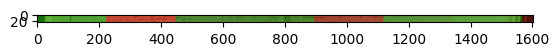

In [49]:
flines = sorted(lines, key=lambda x: x[1])

print(len(flines))
final_filtered_lines = []
for line_bbox in flines:
    x,y,w,h = line_bbox
    plt.imshow( np.array(masked)[y:y+h,x:x+w,:])
    typewritting_sum = np.sum(masked[y:y+h,x:x+w,1])
    handwritten_sum = np.sum(masked[y:y+h,x:x+w,0])


    if handwritten_sum > typewritting_sum + (typewritting_sum*0.1):
        final_filtered_lines.append(line_bbox)

In [50]:
print(len(final_filtered_lines
))

23


In [51]:
flines == final_filtered_lines

False

In [52]:
print(len(flines))
lines_merged = [generate_polygon(*i) for i in sorted(final_filtered_lines, key=lambda x: x[1])]
lines_out = draw_polygons(np.array(cropped_image)/255, polygons=lines_merged)
image_uint8 = (lines_out * 255).astype(np.uint8)
lines_out = Image.fromarray(image_uint8)

31


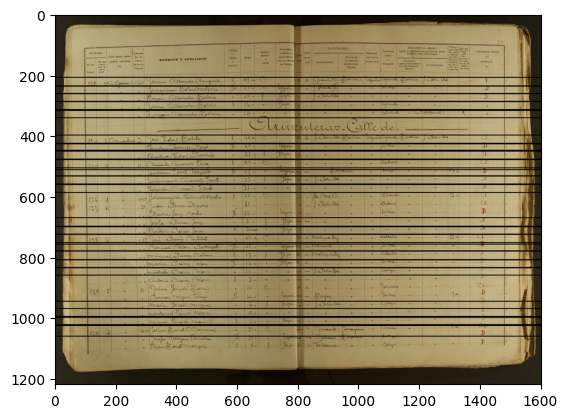

In [53]:
plt.imshow(lines_out)